# steps:

**Npz to fits** <br>
**fits batch STF strech**<br>
**batch to jpg**<br>
**jpg back to colab for cutout**<br>
**cutout save label,save to jpg**<br>
**jpg to yolov5 training**<br>
**job done**<br>

In [ ]:
!pip install galsim==2.3.1
#!pip install pandas==1.2.3
#!pip install numpy==1.19.5
!pip install ztfquery
!pip install astropy
!pip install ssa

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
from glob import glob
import pandas as pd
import matplotlib.pyplot as plt
from ztfquery import query
from astropy.io import fits
from astropy.time import Time
from matplotlib.colors import LogNorm
from astropy.wcs import WCS
from astropy.coordinates import EarthLocation,AltAz,SkyCoord,get_sun
from time import time
import sys
#import ssa
#from ssa import propagator
#from ssa.utils import *


# ZTF data generation


In [ ]:
time_anchor1 = Time('2019-11-18 0:00:00')
time_anchor2 = Time('2019-11-19 0:00:00')
zquery = query.ZTFQuery()
zquery.load_metadata(sql_query='seeing<2 and obsjd>{0} and obsjd<{1}'.format(time_anchor1.jd,time_anchor2.jd))


In [ ]:
obs_times = Time([zquery.metatable[['obsdate']].values[i,0][:-3] for i in range(len(zquery.metatable[['obsdate']].values))])

obs_ra = zquery.metatable['ra'].values
obs_dec = zquery.metatable['dec'].values

ztf = EarthLocation.of_site('Palomar')
ztf_r,_ = ztf.get_gcrs_posvel(obstime=obs_times)

In [ ]:
zquery.download_data('scimrefdiffimg.fits.fz')


In [ ]:
zquery.download_data('diffimgpsf.fits')

In [ ]:
zquery.metatable.columns

Index(['ra', 'dec', 'infobits', 'field', 'ccdid', 'qid', 'rcid', 'fid',
       'filtercode', 'pid', 'nid', 'expid', 'itid', 'imgtype', 'imgtypecode',
       'obsdate', 'obsjd', 'exptime', 'filefracday', 'seeing', 'airmass',
       'moonillf', 'moonesb', 'maglimit', 'crpix1', 'crpix2', 'crval1',
       'crval2', 'cd11', 'cd12', 'cd21', 'cd22', 'ra1', 'dec1', 'ra2', 'dec2',
       'ra3', 'dec3', 'ra4', 'dec4', 'ipac_pub_date', 'ipac_gid'],
      dtype='object')

In [ ]:
data_files = zquery.get_local_data('scimrefdiffimg.fits.fz')
len(data_files)


psf_files = zquery.get_local_data('diffimgpsf.fits')


psf_files_truncated = []
for i in  psf_files:
  psf_files_truncated.append(i[:65])

/usr/local/lib/python3.7/dist-packages/ztfquery/io.py:550: UserWarning: cannot open file ./Data/sci/2019/1118/228970/ztf_20191118228970_000652_zr_c05_o_q4_scimrefdiffimg.fits.fz
  warnings.warn(f"cannot open file {filename}")
/usr/local/lib/python3.7/dist-packages/ztfquery/io.py:556: UserWarning: ./Data/sci/2019/1118/228970/ztf_20191118228970_000652_zr_c05_o_q4_scimrefdiffimg.fits.fz NOT ERASED
  warnings.warn(f"{filename} NOT ERASED")
/usr/local/lib/python3.7/dist-packages/ztfquery/io.py:463: UserWarning: 1 file failed
  warnings.warn(f"{len(fileissue)} file failed")


In [ ]:
len(data_files)

1233

In [ ]:
import galsim




for val in np.arange(0,10):
  count = 0
  i = 0 + 100*val

  data_save = []
  im_inserts = []

  while i < 100*(val+1):
    data_file = data_files[i]
    if data_file[:65] in psf_files_truncated:

      psf_position = np.where(data_file[:65] == np.array(psf_files_truncated))[0][0]

      psf = fits.open(psf_files[psf_position])
      psf_im = galsim.ImageF(psf[0].data)


      galsim_psf = galsim.InterpolatedImage(psf_im,scale=1)
      image = fits.open(data_file)
      im = galsim.ImageF(image[1].data,scale=1)
      magnitude_rands = []
      length_rands = []
      angle_rands = []
      box_rands = []

      for _ in np.arange(20):
        magnitude_rand = np.random.uniform(15,19)
        length_rand = np.random.choice([1,2,3])
        x_center_rand = np.random.uniform(100,2950)
        y_center_rand = np.random.uniform(50,2950)
        angle_rand = np.random.uniform(0,360)


        flux = 10**((26.12 - magnitude_rand)/2.5)
        height = 0.05
        length = length_rand
        angle = angle_rand


        gs_track = galsim.Box(width=length,height = height, flux = flux).rotate(angle*galsim.degrees)
        final_track = galsim.Convolve(galsim_psf,gs_track)

        border = 100
        stamp_size = length + border
        stamp_box = galsim.BoundsI(0,stamp_size,0,stamp_size)
        stamp = galsim.ImageF(stamp_box)

        final_track.drawImage(image = stamp,method = 'no_pixel',scale=1)

        box = galsim.BoundsI(int(x_center_rand),int(x_center_rand)+stamp_size, int(y_center_rand),int(y_center_rand)+stamp_size)
        im[box] += stamp


        magnitude_rands.append(magnitude_rand)
        length_rands.append(length_rand)
        angle_rands.append(angle_rand)
        box_rands.append(box)



      value_frame = pd.DataFrame()
      value_frame['magnitude'] = magnitude_rands
      value_frame['length'] = length_rands
      value_frame['angle'] = angle_rands
      value_frame['box'] = box_rands
      data_save.append([str(psf_files[psf_position]),str(data_file)])

      data_save.append(value_frame)

      im_inserts.append(im.array)
      count +=1


    i+=1
  np.savez('injected_information_' +str(val)+'.npz',data=data_save)
  np.savez('difference_image_'+str(val)+'.npz',data=im_inserts)






/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


# working with images


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
%cd /content/drive/MyDrive/llnl

/content/drive/MyDrive/llnl


In [ ]:
sample_images_0 = np.load('difference_image_0.npz')['data']


In [ ]:
print(sample_images_0.shape)

(100, 3080, 3072)


In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(sample_images_0[0],cmap='Greys_r')


# save label to csv file

In [ ]:


# Convert the npz file label to csv for ease of use

data = np.load('injected_information_0.npz',allow_pickle=True)

for k in range(1,39,2):
  arr =data['data'][k]
  box = arr['box']
  
  cord = np.zeros((20,4))
  for i in range(20):
    for j in range(4):
      if j==0:
        cord[i][j] = box[i].xmin
      if j==1:
        cord[i][j] = box[i].xmax
      if j==2:
        cord[i][j] = box[i].ymin
      if j==3:
        cord[i][j] = box[i].ymax
  number = int((k+1) / 2)
  np.savetxt('/content/drive/My Drive/llnl/label0/box'+ str(number)+'.csv',cord,fmt='%s')

  

# save npz picture to fits


In [ ]:

for i in range(20):
  test_fits = sample_images_0[i]
  hdu = fits.PrimaryHDU(test_fits)

  hdul=fits.HDUList([hdu])
  hdul.writeto('/content/drive/MyDrive/llnl/fits0/Fits'+str(i)+'.fits')

# STF step in pixinishgt, return back to python in jpeg

In [ ]:
from tqdm import tqdm
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
from PIL import Image
counter = 0 
for j in tqdm(range(38)):

  label = np.loadtxt('/content/drive/MyDrive/llnl/label2/box' + str(j+1)+'.csv')
  image = plt.imread('/content/drive/MyDrive/llnl/jpg2_38img/Fits'+str(j)+'.jpg')

  for i in range(20):

    xmin = int(label[i,0])
    xmax = int(label[i,1])
    ymin = int(label[i,2])
    ymax = int(label[i,3])

    cut = image[ymin-60:ymax+60,xmin-60:xmax+60]
    
    im = Image.fromarray(cut)
    #plt.imshow(cut,cmap='Greys_r')

    #plt.gca().add_patch(Rectangle((20,20),20,20,
                      #edgecolor='red',
                      #facecolor='none',
                      #lw=4))
    #plt.axis('off')

    if i <10:
      idx = str(0)+str(i)
    else:
      idx = str(i)

    im.save('/content/drive/MyDrive/llnl/cutout_v2/cutout'+str(j)+idx+'.jpeg')
    #plt.show()
    #plt.savefig('/content/drive/MyDrive/llnl/cutout_v2/cutout'+str(j)+idx+'.png',bbox_inches='tight', pad_inches=0)
    counter +=1
print(counter)

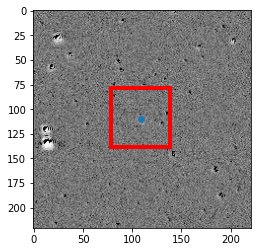

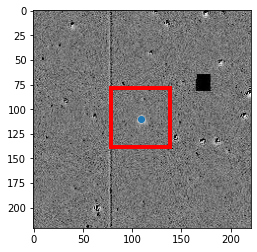

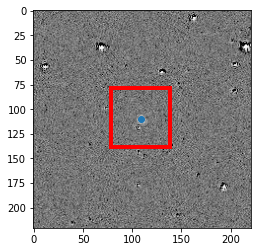

In [ ]:
for i in range(3):
  cutout = plt.imread('/content/drive/MyDrive/llnl/cutout_v2/cutout00'+str(i)+'.jpeg')
  plt.scatter(109,110)
  plt.imshow(cutout,cmap='Greys_r')

  plt.gca().add_patch(Rectangle((78,78),60,60,
                      edgecolor='red',
                      facecolor='none',
                      lw=4))
  plt.show()

In [ ]:
%mkdir cutout_v2_label

# Create yolo label


In [ ]:
x = 109/221
y = 110/221
w,h = 60/221,60/221
print(x,y,w,h)

0.49321266968325794 0.497737556561086 0.27149321266968324 0.27149321266968324


In [ ]:
x = 109/221
y = 110/221
w,h = 60/221,60/221
counter =0
for j in tqdm(range(38)):
  for i in range(20):

    label_vec = np.array([0,x,y,w,h])
    label_vec = label_vec.reshape(1,5)
    if i <10:
      idx = str(0)+str(i)
    else:
      idx = str(i)

    np.savetxt('/content/drive/MyDrive/llnl/cutout_v2_label/cutout'+ str(j)+idx+'.txt',label_vec,fmt='%s')
    counter +=1

In [ ]:
print(counter)

760


# after YOLO training, check result

In [ ]:
import matplotlib.patches as patches
from matplotlib.patches import Rectangle

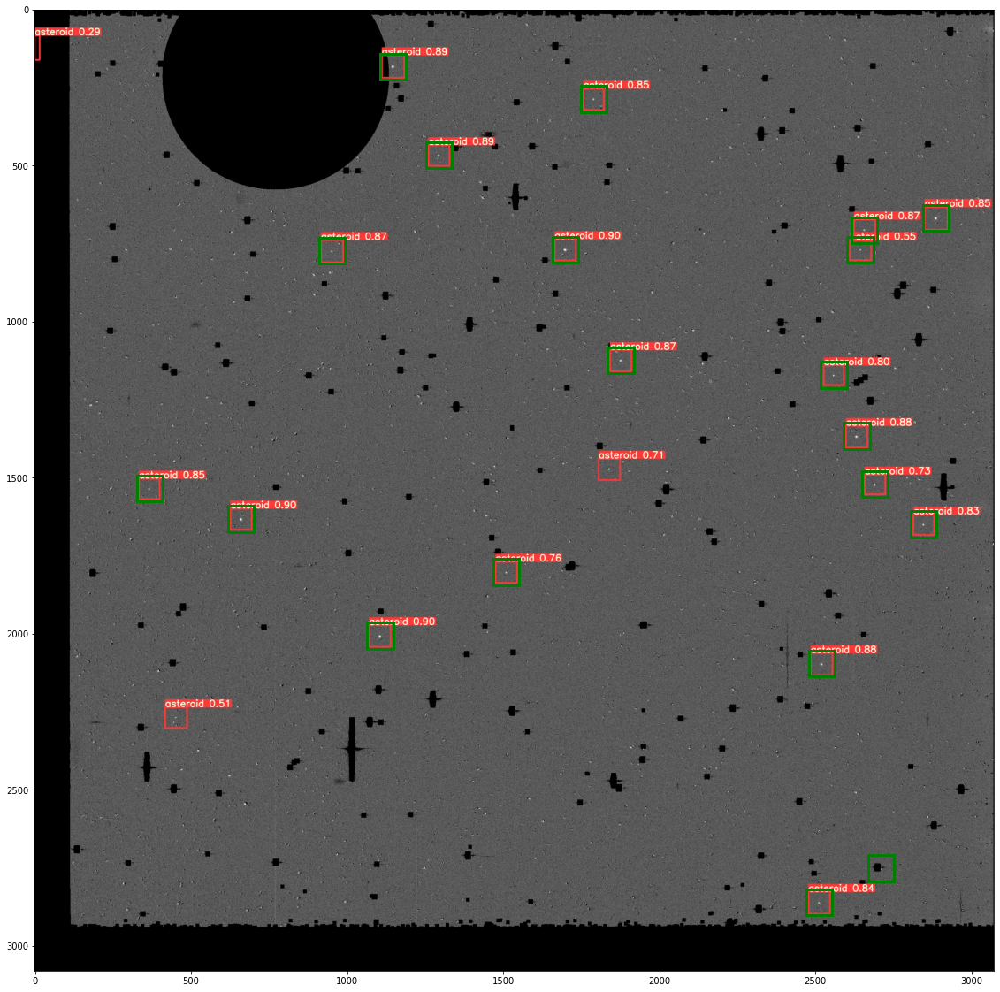

In [ ]:
plt.figure(figsize=(20,20))
img = plt.imread('/content/drive/MyDrive/llnl/detection4/Fits0.jpg')
plt.imshow(img)

label = np.loadtxt('/content/drive/MyDrive/llnl/label0/box1.csv')

for i in range(20):
  plt.gca().add_patch(Rectangle((label[i,0]+9,label[i,3]-95),83,83,
                      edgecolor='green',
                      facecolor='none',
                      lw=3))
plt.show()

# Save result output

 95%|█████████▌| 19/20 [01:11<00:03,  3.97s/it]

OSError: ignored

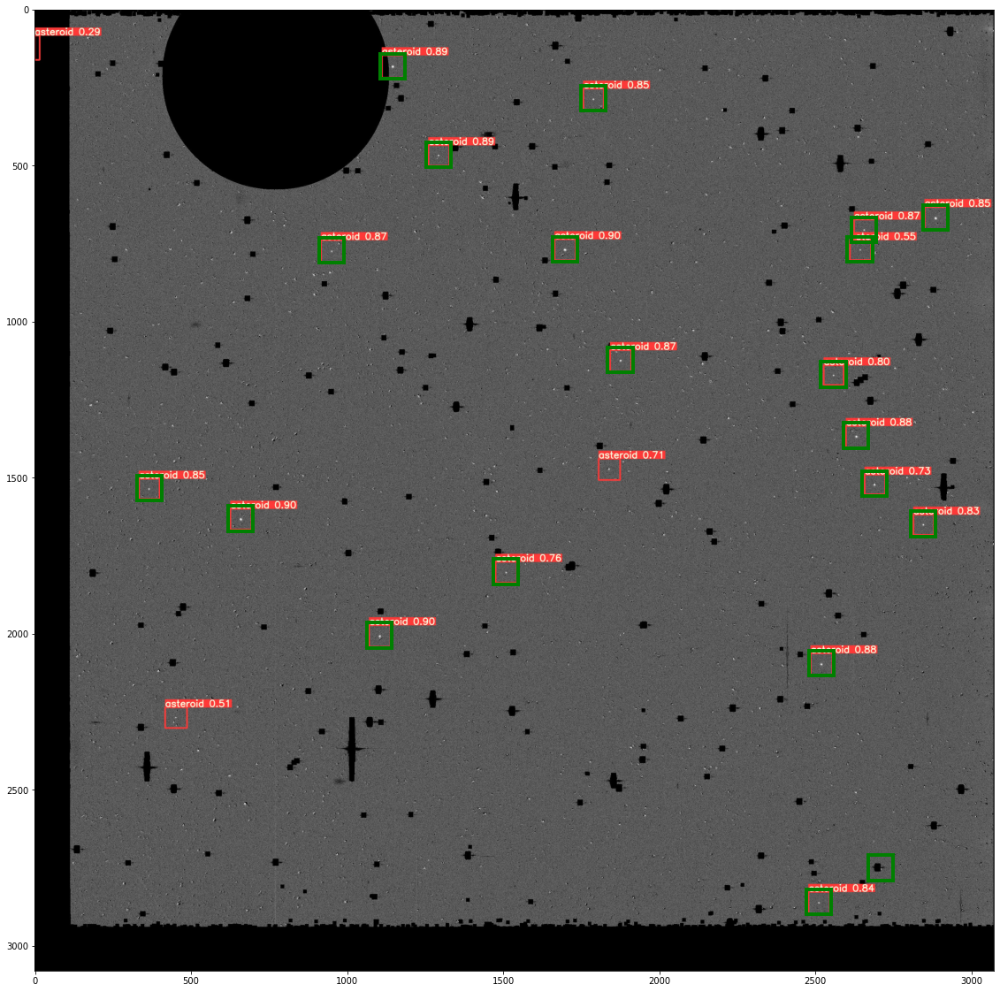

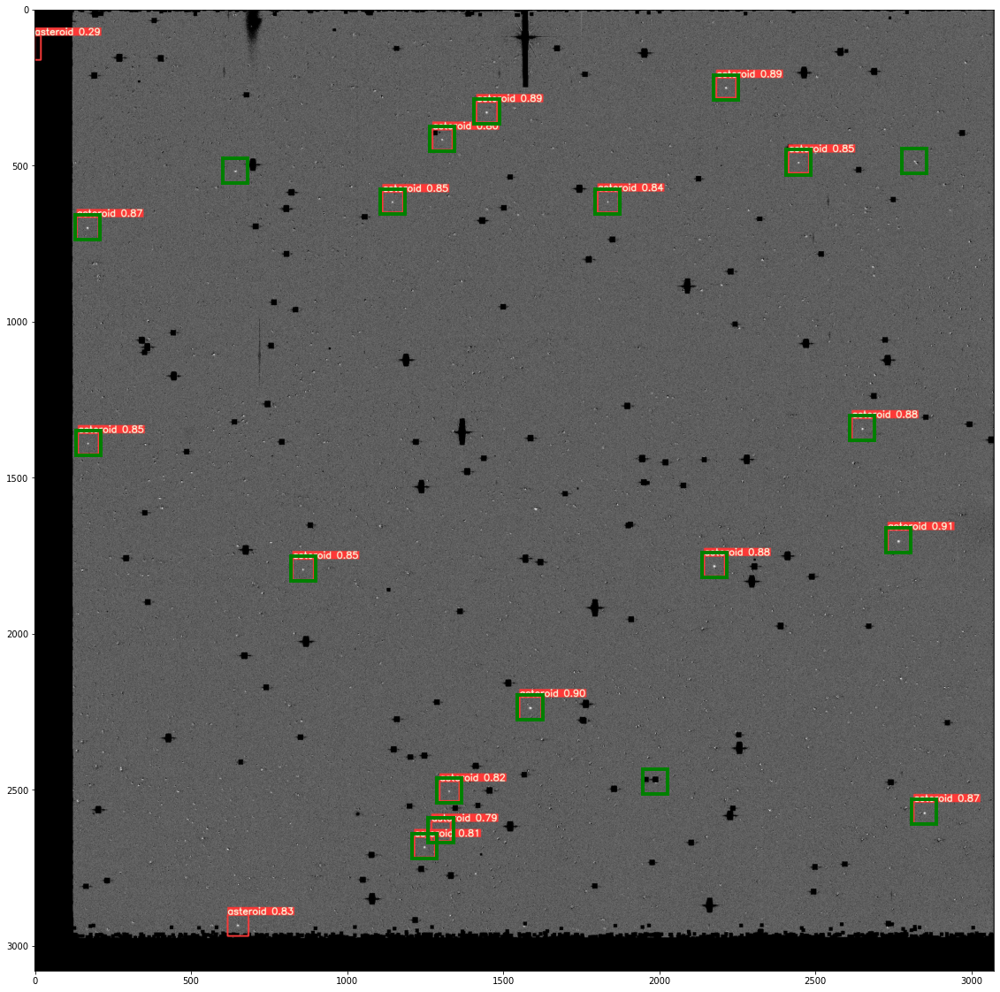

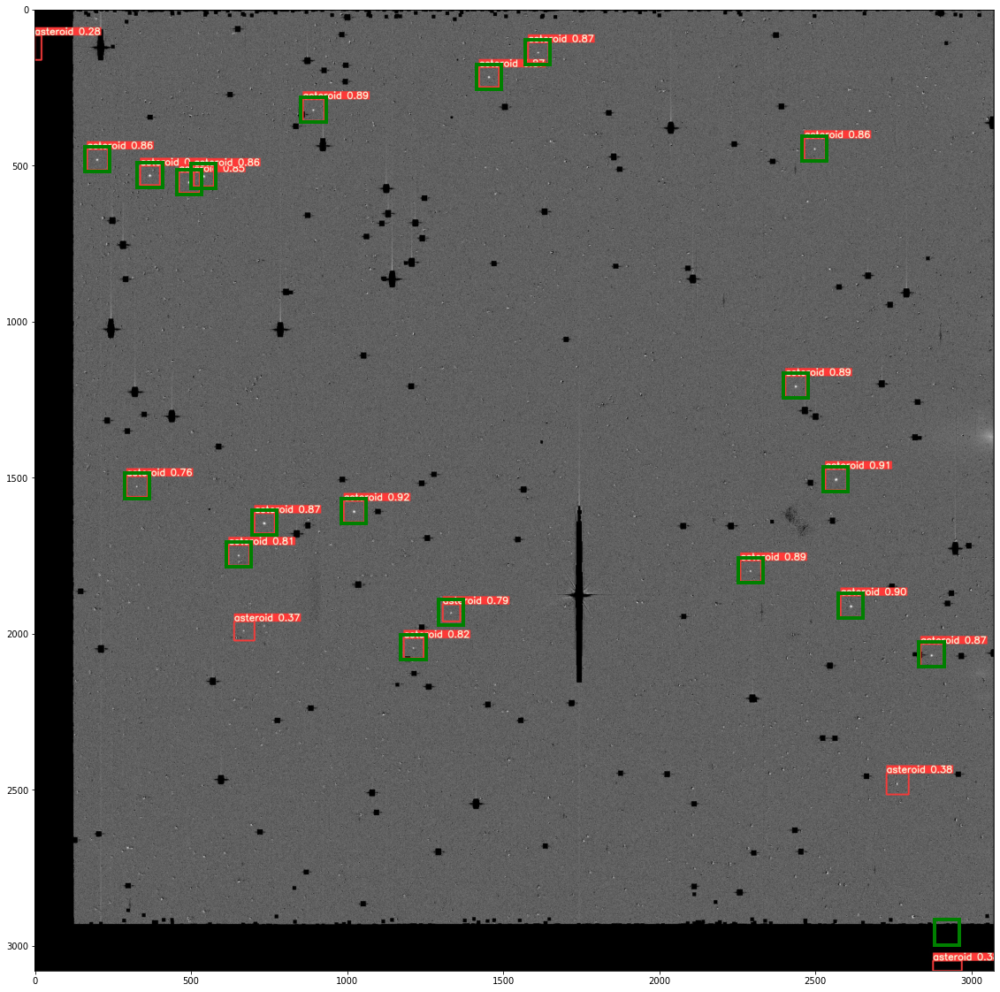

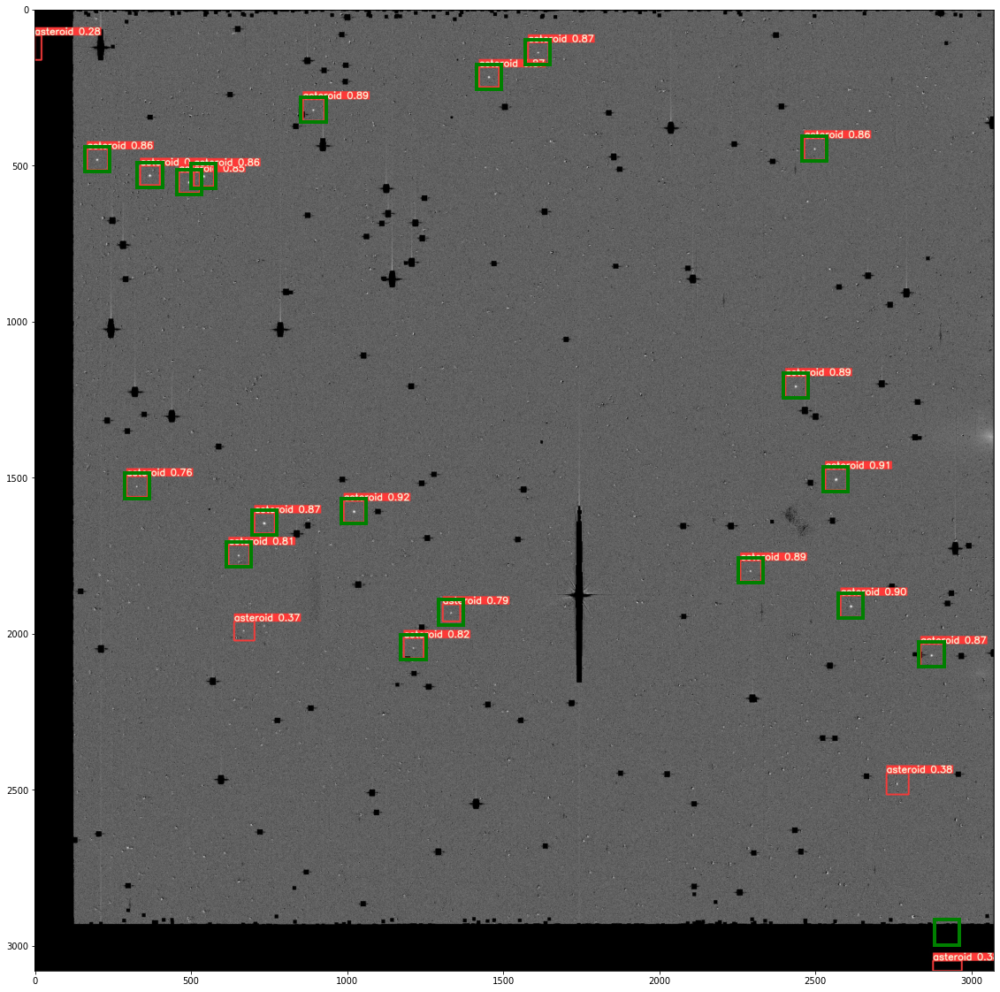

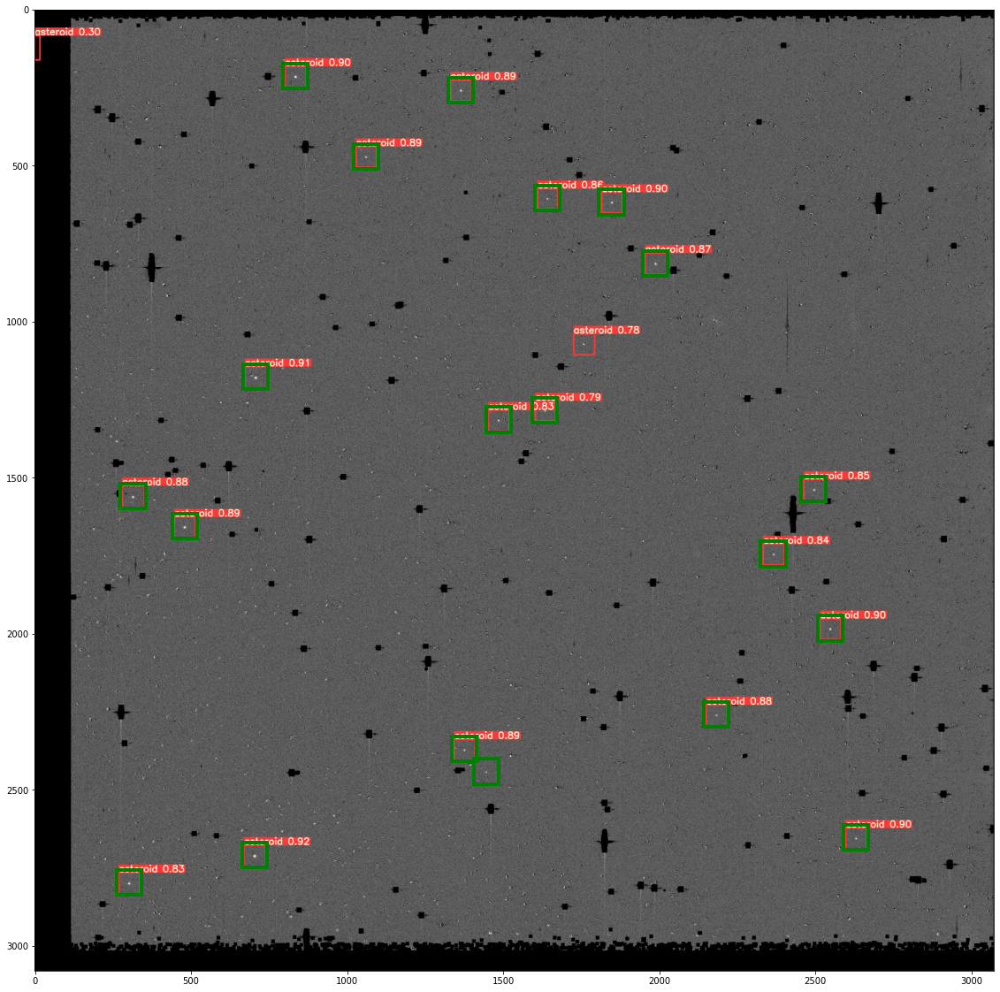

...

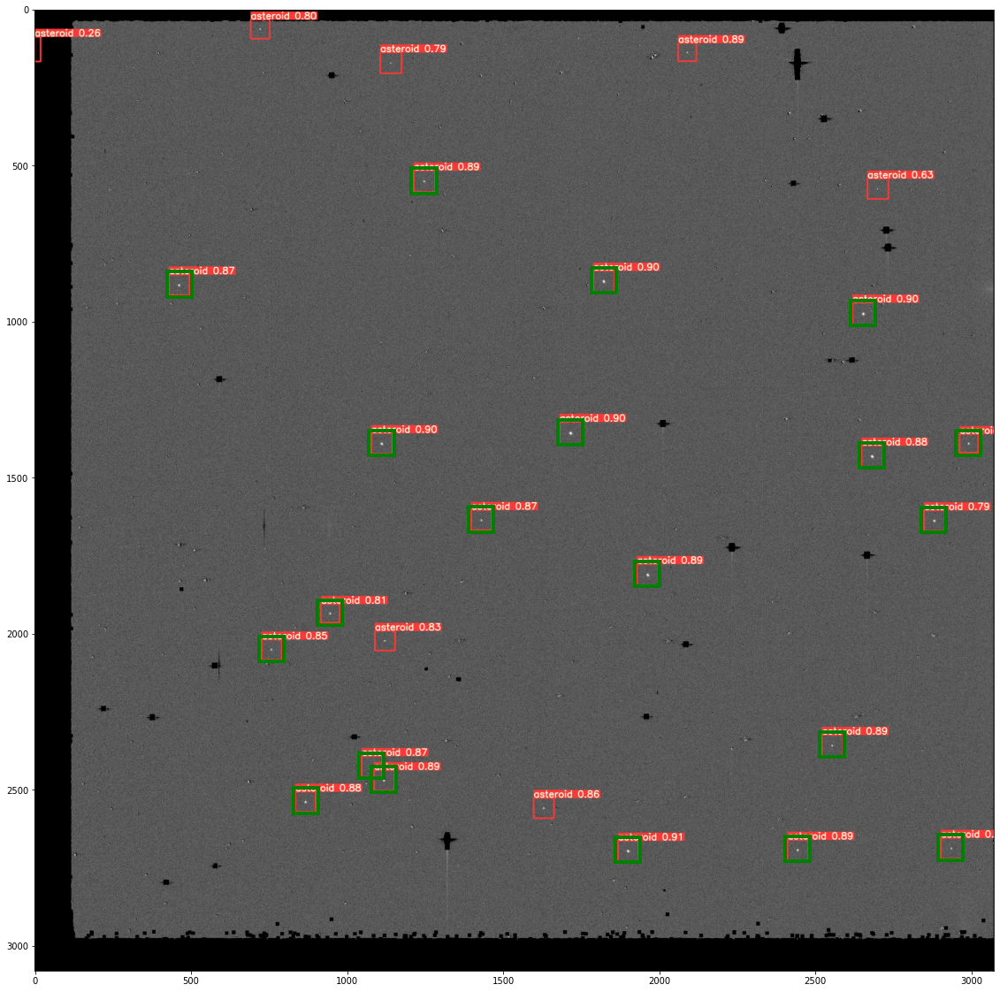

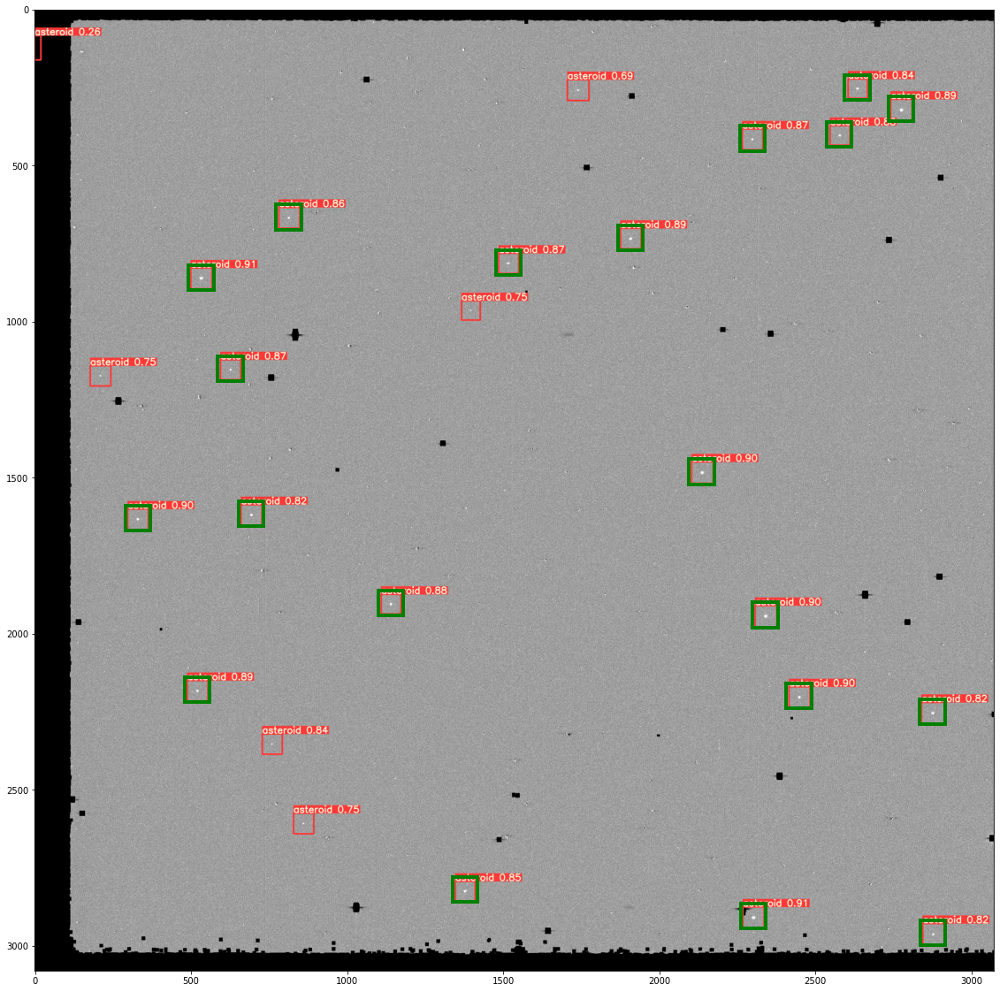

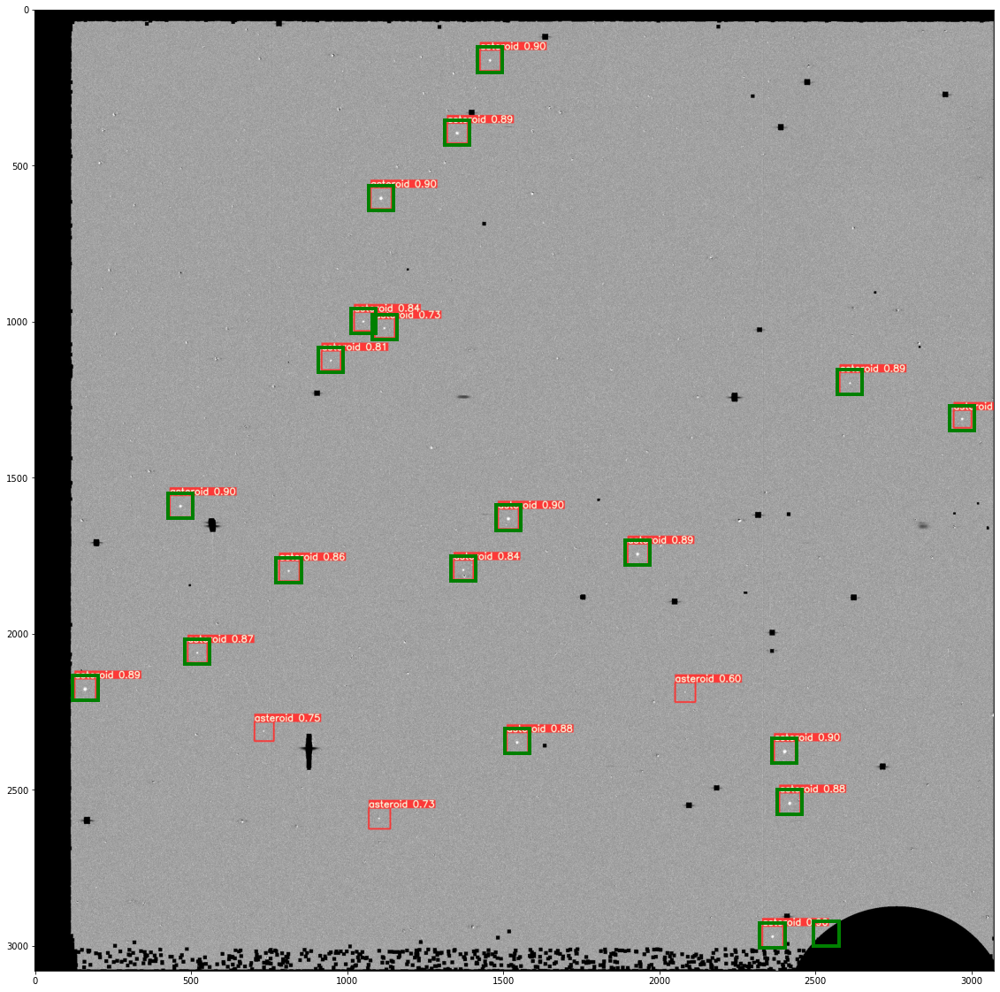

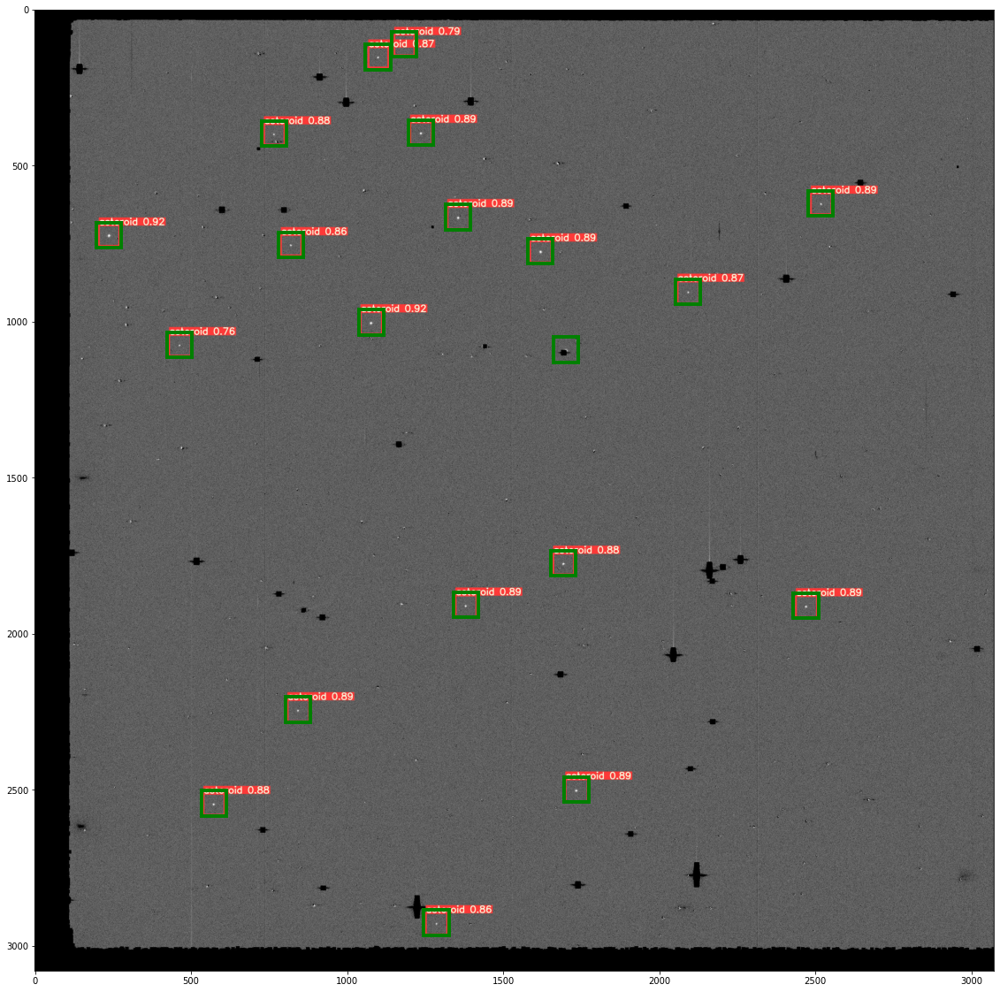

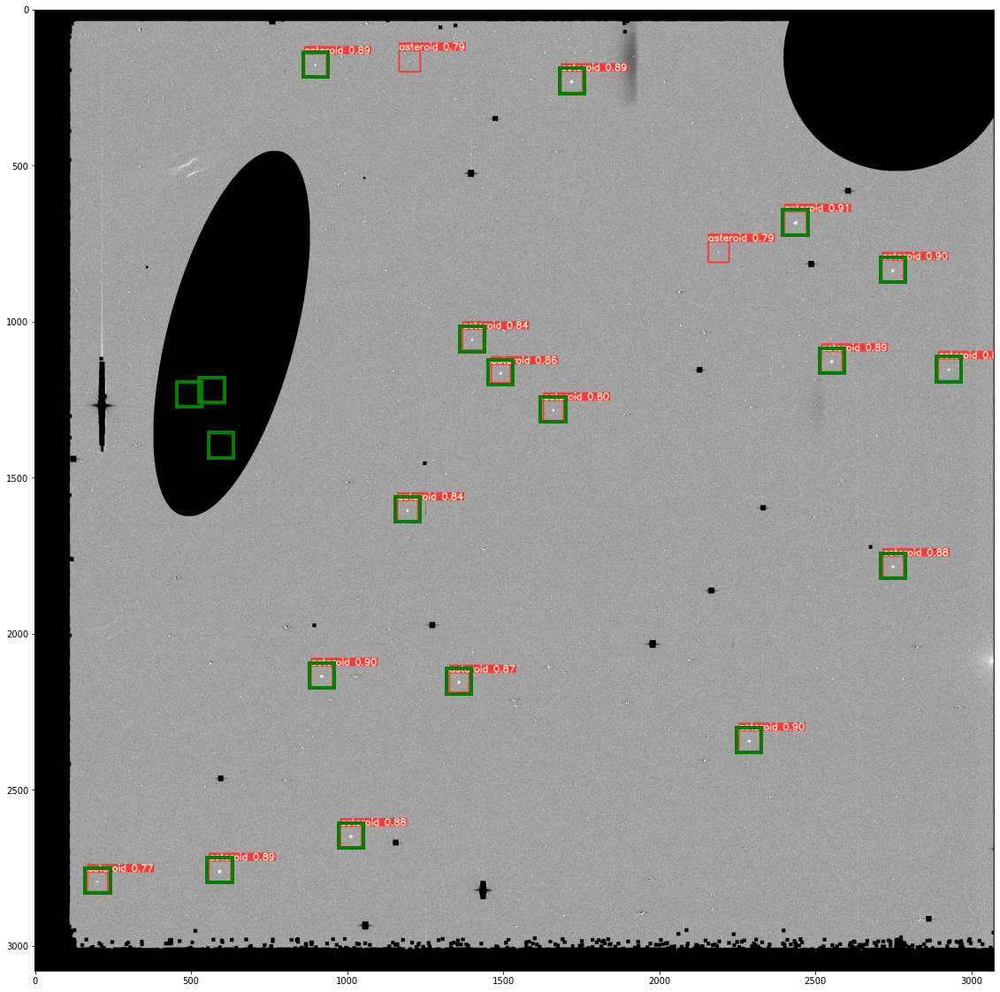

<Figure size 1440x1440 with 0 Axes>

In [ ]:
from tqdm import tqdm
for k in tqdm(range(20)):
  plt.figure(figsize=(20,20))
  if k ==3:
    pass
  else:

    img = plt.imread('/content/drive/MyDrive/llnl/detection4/Fits'+str(k)+'.jpg')
    

    label = np.loadtxt('/content/drive/MyDrive/llnl/label0/box'+str(k+1)+'.csv')
  plt.imshow(img)
  for i in range(20):
    plt.gca().add_patch(Rectangle((label[i,0]+9,label[i,3]-95),80,80,
                      edgecolor='green',
                      facecolor='none',
                      lw=4))
  
  
  plt.savefig('/content/drive/MyDrive/llnl/detection4/result/result'+str(k)+'.png',bbox_inches='tight', pad_inches=0)